In [1]:
import pandas as pd
import re










pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)

In [2]:
df = pd.read_csv('gurgaon_properties_cleaned_v1.csv')

In [3]:
df.duplicated().sum()

122

In [4]:
df.sample(1)

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features
2331,flat,mrg world ultimus,sector 90,0.5,6983.0,716.0,Carpet area: 716 (66.52 sq.m.),2.0,2.0,2,notavailabe,1.0,North-East,Mar-24,"['Huda Metro Station', 'Aanyaz Mall', 'Sector ...",NaN,"['Lift(s)', 'Maintenance Staff', 'Water Storag..."


In [5]:
# feature engineering 
# areaWithType , additionalRoom , agePossesion  , furnishDetails , features

In [6]:
df[['area','areaWithType']].sample(5)

,area,areaWithType
619,5478.83,Plot area 5480(509.11 sq.m.)
976,1485.00,Super Built up area 1485(137.96 sq.m.)
3321,1447.00,Carpet area: 1447 (134.43 sq.m.)
2579,545.00,Carpet area: 545 (50.63 sq.m.)
1105,1385.00,Carpet area: 1385 (128.67 sq.m.)


### 1 . areaWithType

In [7]:
df.sample(5)[['price','area','areaWithType']]

,price,area,areaWithType
953,1.80,2040.0,Super Built up area 1700(157.94 sq.m.)
41,1.38,2177.0,Carpet area: 2177 (202.25 sq.m.)
194,0.90,1244.0,Carpet area: 1244 (115.57 sq.m.)
2230,3.65,3194.0,Built Up area: 2800 (260.13 sq.m.)
2916,1.80,2030.0,Super Built up area 2030(188.59 sq.m.)Carpet a...


In [8]:
# This Function extracts the super built up area

def get_super_built_up_area(text):
    match = re.search(r'Super Built up area (\d+\.?\d*)',text)
    if match:
        return float(match.group(1))
    return None

In [9]:
# This function extracts the Built Up area or Carpet area
def get_area(text, area_type):
    match = re.search(area_type + r'\s*:\s*(\d+\.?\d*)', text)
    if match:
        return float(match.group(1))
    return None

In [10]:
def convert_to_sqft(text,area_value):
    if area_value is None:
        return None
    else:
        match = re.search(r'{} \((\d+\.?\d*) sq.m.\)'.format(area_value),text)
        if match:
            sq_m_value = float(match.group(1))
            
            return sq_m_value*10.739
            
        return area_value
            
            
            
    

In [11]:
df['super_built_up_area'] = df['areaWithType'].apply(get_super_built_up_area)

In [12]:
df['super_built_up_area'] = df.apply(lambda x : convert_to_sqft(x['areaWithType'], x['super_built_up_area']),axis = 1)

In [13]:
df['Built_Up_area']  = df['areaWithType'].apply(lambda x : get_area(x, 'Built Up area'))

In [14]:
df['Built_Up_area'] = df.apply(lambda x : convert_to_sqft(x['areaWithType'],x['Built_Up_area']), axis = 1)


In [15]:
df['Built_Up_area'] = round(df['Built_Up_area'])

In [16]:
df['Carpet_area'] = df['areaWithType'].apply(lambda x : get_area( x , 'Carpet area'))

In [17]:
df['Carpet_area'] = df.apply(lambda x : convert_to_sqft(x['areaWithType'],x['Carpet_area']),axis = 1)

In [18]:
df

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,Built_Up_area,Carpet_area
0,flat,ambience creacions,sector 22,3.99,12912.0,3090.00,Super Built up area 3090(287.07 sq.m.),3.0,5.0,3+,servant room,3.0,NaN,Within 6 months,"['Moulsari Avenue', 'Ambience Mall', 'Old Delh...","['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...","['Security / Fire Alarm', 'Intercom Facility',...",3090.00,NaN,NaN
1,flat,raheja revanta,sector 78,1.20,10018.0,1198.00,Super Built up area 1197.8(111.28 sq.m.)Carpet...,1.0,2.0,2,notavailabe,32.0,NaN,Under Construction,"['Sapphire 83 Mall', 'NH-8', 'Bal Bharti Publi...",NaN,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo...",1197.80,NaN,505.00000
2,house,notAvailable,sector 12,3.50,133079.0,258.33,Plot area 263(24.43 sq.m.)Built Up area: 4800 ...,8.0,8.0,3+,"pooja room,study room,servant room",3.0,South-East,1 to 5 Year Old,"['Hanuman Mandir', 'Dental Health Centre', 'No...","['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...","['Private Garden / Terrace', 'High Ceiling Hei...",NaN,4800.0,4400.00000
3,house,notAvailable,sector 43,13.50,50000.0,2701.74,Plot area 300(250.84 sq.m.),16.0,16.0,3+,"pooja room,study room,servant room,others",4.0,North-West,1 to 5 Year Old,"['Huda city centre metro station', 'New Life C...",NaN,"['Feng Shui / Vaastu Compliant', 'Private Gard...",NaN,NaN,NaN
4,flat,ss the leaf,sector 85,2.10,7467.0,2812.00,Super Built up area 2812(261.24 sq.m.)Built Up...,4.0,4.0,3,"pooja room,study room,servant room",7.0,North,1 to 5 Year Old,"['Sapphire 83 Mall', 'Dwarka Expressway', 'Cen...","['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...","['Feng Shui / Vaastu Compliant', 'Security / F...",2812.00,2600.0,2400.00000
5,house,jacob pura,sector 12,0.35,9722.0,355.21,Built Up area: 360 (33.45 sq.m.),2.0,1.0,0,notAvailabel,NaN,NaN,10+ Year Old,NaN,[],NaN,NaN,360.0,NaN
6,flat,vatika gurgaon,sector 83,1.15,5808.0,1980.00,Super Built up area 1980(183.95 sq.m.)Built Up...,3.0,3.0,2,"pooja room,store room,study room,servant room",3.0,South,1 to 5 Year Old,"['Huda Metro Station (Gurugram)', 'Sapphire 83...","['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge...","['Water purifier', 'Security / Fire Alarm', 'P...",1980.00,1350.0,1308.00000
7,flat,unitech uniworld gardens,sector 47,1.05,10531.0,997.00,Carpet area: 997 (92.62 sq.m.),2.0,2.0,2,notavailabe,3.0,North-East,1 to 5 Year Old,"['Standard chartered ATM', 'Icici bank ATM', '...","['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Security / F...",NaN,NaN,997.00000
8,flat,sare crescent parc,sector 92,0.95,5013.0,1895.00,Built Up area: 1895 (176.05 sq.m.)Carpet area:...,4.0,5.0,3+,notavailabe,13.0,North,undefined,NaN,NaN,NaN,NaN,1895.0,1500.00000
9,house,vatika sovereign next,sector 82a,3.85,7500.0,5145.14,Built Up area: 5140 (477.52 sq.m.),5.0,6.0,3+,notAvailabel,6.0,NaN,undefined,"['Orris Community Center', 'Petrol Pump Indian...","['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",NaN,NaN,5140.0,NaN


In [19]:
df[['price','property_type','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']].sample(5)

,price,property_type,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
64,1.15,flat,1755.0,Super Built up area 1755(163.04 sq.m.),1755.0,NaN,NaN
168,1.14,flat,1772.0,Super Built up area 1772(164.62 sq.m.),1772.0,NaN,NaN
1459,1.49,flat,1838.0,Super Built up area 1832(170.2 sq.m.)Carpet ar...,1832.0,NaN,1580.0
1955,0.98,flat,1620.0,Super Built up area 1620(150.5 sq.m.),1620.0,NaN,NaN
1505,1.15,flat,1616.0,Super Built up area 1616(150.13 sq.m.)Carpet a...,1616.0,NaN,1168.0


In [20]:
df.duplicated().sum()

122

In [21]:
df[~(df['super_built_up_area'].isnull() | df['Built_Up_area'].isnull() | df['Carpet_area'].isnull())][['price','property_type','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']].shape

(534, 7)

In [22]:
df[df['super_built_up_area'].isnull() & df['Built_Up_area'].isnull() & df['Carpet_area'].isnull()][['price','property_type','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']]

,price,property_type,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
3,13.50,house,2701.74,Plot area 300(250.84 sq.m.),NaN,NaN,NaN
18,0.50,house,452.08,Plot area 450(41.81 sq.m.),NaN,NaN,NaN
21,7.25,house,2723.27,Plot area 303(253.35 sq.m.),NaN,NaN,NaN
23,0.45,house,904.17,Plot area 900(83.61 sq.m.),NaN,NaN,NaN
38,1.50,house,1345.49,Plot area 150(125.42 sq.m.),NaN,NaN,NaN
45,3.75,house,1463.89,Plot area 163(136.29 sq.m.),NaN,NaN,NaN
53,1.95,house,1442.36,Plot area 160(133.78 sq.m.),NaN,NaN,NaN
56,1.00,house,129.17,Plot area 126(11.71 sq.m.),NaN,NaN,NaN
75,0.75,house,710.42,Plot area 713(66.24 sq.m.),NaN,NaN,NaN
91,2.50,house,1560.77,Plot area 173(144.65 sq.m.),NaN,NaN,NaN


In [23]:
df[df['areaWithType'].str.contains('Plot')][['price','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']]

,price,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
2,3.50,258.33,Plot area 263(24.43 sq.m.)Built Up area: 4800 ...,NaN,4800.0,4400.0
3,13.50,2701.74,Plot area 300(250.84 sq.m.),NaN,NaN,NaN
13,1.20,850.35,Plot area 846(78.6 sq.m.)Built Up area: 846 sq...,NaN,846.0,NaN
15,2.43,1636.11,Plot area 181.33(151.61 sq.m.)Built Up area: 3...,NaN,345.0,NaN
18,0.50,452.08,Plot area 450(41.81 sq.m.),NaN,NaN,NaN
21,7.25,2723.27,Plot area 303(253.35 sq.m.),NaN,NaN,NaN
23,0.45,904.17,Plot area 900(83.61 sq.m.),NaN,NaN,NaN
24,1.35,1345.49,Plot area 150(125.42 sq.m.)Built Up area: 2052...,NaN,2052.0,NaN
38,1.50,1345.49,Plot area 150(125.42 sq.m.),NaN,NaN,NaN
45,3.75,1463.89,Plot area 163(136.29 sq.m.),NaN,NaN,NaN


In [24]:
df.isnull().sum()

property_type             0
society                   0
sector                    0
price                    18
price_per_sqft           18
area                      1
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 22
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
Built_Up_area          2616
Carpet_area            1859
dtype: int64

In [25]:
all_nan_df = df[df['super_built_up_area'].isnull() & df['Built_Up_area'].isnull() & df['Carpet_area'].isnull()][['price','property_type','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']]

In [26]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
3,13.50,house,2701.74,Plot area 300(250.84 sq.m.),NaN,NaN,NaN
18,0.50,house,452.08,Plot area 450(41.81 sq.m.),NaN,NaN,NaN
21,7.25,house,2723.27,Plot area 303(253.35 sq.m.),NaN,NaN,NaN
23,0.45,house,904.17,Plot area 900(83.61 sq.m.),NaN,NaN,NaN
38,1.50,house,1345.49,Plot area 150(125.42 sq.m.),NaN,NaN,NaN
45,3.75,house,1463.89,Plot area 163(136.29 sq.m.),NaN,NaN,NaN
53,1.95,house,1442.36,Plot area 160(133.78 sq.m.),NaN,NaN,NaN
56,1.00,house,129.17,Plot area 126(11.71 sq.m.),NaN,NaN,NaN
75,0.75,house,710.42,Plot area 713(66.24 sq.m.),NaN,NaN,NaN
91,2.50,house,1560.77,Plot area 173(144.65 sq.m.),NaN,NaN,NaN


In [27]:
all_nan_index = df[df['super_built_up_area'].isnull() & df['Built_Up_area'].isnull() & df['Carpet_area'].isnull()][['price','property_type','area','areaWithType','super_built_up_area','Built_Up_area','Carpet_area']].index

In [28]:
def extract_plot(area_with_type):
    match = re.search(r'Plot area ((\d+\.?\d*))',area_with_type)
    if match:
        return float(match.group(1))
    else:
        return None

In [29]:
all_nan_df['Built_Up_area'] = all_nan_df['areaWithType'].apply(extract_plot)

In [30]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
3,13.50,house,2701.74,Plot area 300(250.84 sq.m.),NaN,300.00,NaN
18,0.50,house,452.08,Plot area 450(41.81 sq.m.),NaN,450.00,NaN
21,7.25,house,2723.27,Plot area 303(253.35 sq.m.),NaN,303.00,NaN
23,0.45,house,904.17,Plot area 900(83.61 sq.m.),NaN,900.00,NaN
38,1.50,house,1345.49,Plot area 150(125.42 sq.m.),NaN,150.00,NaN
45,3.75,house,1463.89,Plot area 163(136.29 sq.m.),NaN,163.00,NaN
53,1.95,house,1442.36,Plot area 160(133.78 sq.m.),NaN,160.00,NaN
56,1.00,house,129.17,Plot area 126(11.71 sq.m.),NaN,126.00,NaN
75,0.75,house,710.42,Plot area 713(66.24 sq.m.),NaN,713.00,NaN
91,2.50,house,1560.77,Plot area 173(144.65 sq.m.),NaN,173.00,NaN


In [31]:
import numpy as np

def convert_to_scale(row):
    if np.isnan(row['area'] or row['Built_Up_area']):
        return row['Built_up_area']
    else:
        if round(row['area'] / row['Built_Up_area']) == 9.0:
            return row['Built_Up_area'] * 9.0
        elif round(row['area']/row['Built_Up_area']) == 11.0:
            return row['Built_Up_area'] * 10.73
        else:
            return row['Built_Up_area']
        
            

In [32]:
all_nan_df['Built_Up_area'] = all_nan_df.apply(convert_to_scale,axis = 1)

In [33]:
all_nan_df

,price,property_type,area,areaWithType,super_built_up_area,Built_Up_area,Carpet_area
3,13.50,house,2701.74,Plot area 300(250.84 sq.m.),NaN,2700.00,NaN
18,0.50,house,452.08,Plot area 450(41.81 sq.m.),NaN,450.00,NaN
21,7.25,house,2723.27,Plot area 303(253.35 sq.m.),NaN,2727.00,NaN
23,0.45,house,904.17,Plot area 900(83.61 sq.m.),NaN,900.00,NaN
38,1.50,house,1345.49,Plot area 150(125.42 sq.m.),NaN,1350.00,NaN
45,3.75,house,1463.89,Plot area 163(136.29 sq.m.),NaN,1467.00,NaN
53,1.95,house,1442.36,Plot area 160(133.78 sq.m.),NaN,1440.00,NaN
56,1.00,house,129.17,Plot area 126(11.71 sq.m.),NaN,126.00,NaN
75,0.75,house,710.42,Plot area 713(66.24 sq.m.),NaN,713.00,NaN
91,2.50,house,1560.77,Plot area 173(144.65 sq.m.),NaN,1557.00,NaN


In [34]:
df.update(all_nan_df)

In [35]:
df.isnull().sum()

property_type             0
society                   0
sector                    0
price                    18
price_per_sqft           18
area                      1
areaWithType              0
bedRoom                   0
bathroom                  0
balcony                   0
additionalRoom            0
floorNum                 22
facing                 1105
agePossession             1
nearbyLocations         177
furnishDetails          981
features                635
super_built_up_area    1888
Built_Up_area          2070
Carpet_area            1859
dtype: int64

# aditional room

In [36]:
df['additionalRoom'].value_counts()

additionalRoom
notavailabe                                      1261
servant room                                      705
notAvailabel                                      326
study room                                        250
others                                            225
pooja room                                        165
store room                                         99
study room,servant room                            99
pooja room,servant room                            82
pooja room,study room,servant room,store room      72
servant room,others                                60
pooja room,study room,servant room                 55
pooja room,study room,servant room,others          54
servant room,pooja room                            38
servant room,store room                            33
study room,others                                  29
pooja room,study room                              22
pooja room,others                                  17
pooja room,st

In [37]:
new_col = ['study room','store room' , 'pooja room', 'servant room','others']


for col in new_col:
    df[col] = df['additionalRoom'].str.contains(col).astype('int')

In [38]:
df.sample(5)[['additionalRoom','study room','store room','pooja room','servant room','others']]

,additionalRoom,study room,store room,pooja room,servant room,others
753,others,0,0,0,0,1
2151,notAvailabel,0,0,0,0,0
2676,notavailabe,0,0,0,0,0
1102,notavailabe,0,0,0,0,0
896,"pooja room,study room,store room",1,1,1,0,0


# 3.agePossession

In [39]:
df['agePossession']

0          Within 6 months
1       Under Construction
2          1 to 5 Year Old
3          1 to 5 Year Old
4          1 to 5 Year Old
5             10+ Year Old
6          1 to 5 Year Old
7          1 to 5 Year Old
8                undefined
9                undefined
10         1 to 5 Year Old
11        5 to 10 Year Old
12            10+ Year Old
13         1 to 5 Year Old
14         1 to 5 Year Old
15            10+ Year Old
16      Under Construction
17               undefined
18        5 to 10 Year Old
19         1 to 5 Year Old
20         1 to 5 Year Old
21        5 to 10 Year Old
22         1 to 5 Year Old
23            10+ Year Old
24            10+ Year Old
25                  Jan-24
26         1 to 5 Year Old
27         1 to 5 Year Old
28            10+ Year Old
29         0 to 1 Year Old
30               undefined
31         1 to 5 Year Old
32         0 to 1 Year Old
33         1 to 5 Year Old
34                  Jan-26
35         1 to 5 Year Old
36         1 to 5 Year Old
3

In [40]:
def categorise_age_possession(value):
    if pd.isna(value):
        return 'Undefined'
    if '0 to 1 Year Old' in value or 'Within 6 months' in value or 'within 3 months' in value:
        return 'new property'
    if '1 to 5 Year Old' in value:
        return 'relatively new'
    if '5 to 10 Year Old' in value:
        return 'moderately old'
    if '10+ Year Old':
        return 'Old'
    
    try:
        int(value.split(' ')[-1])
        return 'Under Construction'
    except:
        return 'undefined'

In [41]:
def categorize_age_possession(value):
    if pd.isna(value):
        return "Undefined"
    if "0 to 1 Year Old" in value or "Within 6 months" in value or "Within 3 months" in value:
        return "New Property"
    if "1 to 5 Year Old" in value:
        return "Relatively New"
    if "5 to 10 Year Old" in value:
        return "Moderately Old"
    if "10+ Year Old" in value:
        return "Old Property"
    if "Under Construction" in value or "By" in value:
        return "Under Construction"
    try:
        # For entries like 'May 2024'
        int(value.split(" ")[-1])
        return "Under Construction"
    except:
        return "Undefined"

In [42]:
df['agePossession']=df['agePossession'].apply(categorize_age_possession)

In [43]:
df['agePossession'].value_counts()

agePossession
Relatively New        1676
New Property           626
Moderately Old         575
Undefined              476
Old Property           310
Under Construction     140
Name: count, dtype: int64

In [44]:
df

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,Built_Up_area,Carpet_area,study room,store room,pooja room,servant room,others
0,flat,ambience creacions,sector 22,3.99,12912.0,3090.00,Super Built up area 3090(287.07 sq.m.),3.0,5.0,3+,servant room,3.0,NaN,New Property,"['Moulsari Avenue', 'Ambience Mall', 'Old Delh...","['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...","['Security / Fire Alarm', 'Intercom Facility',...",3090.00,NaN,NaN,0,0,0,1,0
1,flat,raheja revanta,sector 78,1.20,10018.0,1198.00,Super Built up area 1197.8(111.28 sq.m.)Carpet...,1.0,2.0,2,notavailabe,32.0,NaN,Under Construction,"['Sapphire 83 Mall', 'NH-8', 'Bal Bharti Publi...",NaN,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo...",1197.80,NaN,505.00000,0,0,0,0,0
2,house,notAvailable,sector 12,3.50,133079.0,258.33,Plot area 263(24.43 sq.m.)Built Up area: 4800 ...,8.0,8.0,3+,"pooja room,study room,servant room",3.0,South-East,Relatively New,"['Hanuman Mandir', 'Dental Health Centre', 'No...","['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...","['Private Garden / Terrace', 'High Ceiling Hei...",NaN,4800.00,4400.00000,1,0,1,1,0
3,house,notAvailable,sector 43,13.50,50000.0,2701.74,Plot area 300(250.84 sq.m.),16.0,16.0,3+,"pooja room,study room,servant room,others",4.0,North-West,Relatively New,"['Huda city centre metro station', 'New Life C...",NaN,"['Feng Shui / Vaastu Compliant', 'Private Gard...",NaN,2700.00,NaN,1,0,1,1,1
4,flat,ss the leaf,sector 85,2.10,7467.0,2812.00,Super Built up area 2812(261.24 sq.m.)Built Up...,4.0,4.0,3,"pooja room,study room,servant room",7.0,North,Relatively New,"['Sapphire 83 Mall', 'Dwarka Expressway', 'Cen...","['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...","['Feng Shui / Vaastu Compliant', 'Security / F...",2812.00,2600.00,2400.00000,1,0,1,1,0
5,house,jacob pura,sector 12,0.35,9722.0,355.21,Built Up area: 360 (33.45 sq.m.),2.0,1.0,0,notAvailabel,NaN,NaN,Old Property,NaN,[],NaN,NaN,360.00,NaN,0,0,0,0,0
6,flat,vatika gurgaon,sector 83,1.15,5808.0,1980.00,Super Built up area 1980(183.95 sq.m.)Built Up...,3.0,3.0,2,"pooja room,store room,study room,servant room",3.0,South,Relatively New,"['Huda Metro Station (Gurugram)', 'Sapphire 83...","['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge...","['Water purifier', 'Security / Fire Alarm', 'P...",1980.00,1350.00,1308.00000,1,1,1,1,0
7,flat,unitech uniworld gardens,sector 47,1.05,10531.0,997.00,Carpet area: 997 (92.62 sq.m.),2.0,2.0,2,notavailabe,3.0,North-East,Relatively New,"['Standard chartered ATM', 'Icici bank ATM', '...","['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Security / F...",NaN,NaN,997.00000,0,0,0,0,0
8,flat,sare crescent parc,sector 92,0.95,5013.0,1895.00,Built Up area: 1895 (176.05 sq.m.)Carpet area:...,4.0,5.0,3+,notavailabe,13.0,North,Undefined,NaN,NaN,NaN,NaN,1895.00,1500.00000,0,0,0,0,0
9,house,vatika sovereign next,sector 82a,3.85,7500.0,5145.14,Built Up area: 5140 (477.52 sq.m.),5.0,6.0,3+,notAvailabel,6.0,NaN,Undefined,"['Orris Community Center', 'Petrol Pump Indian...","['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",NaN,NaN,5140.00,NaN,0,0,0,0,0


# FurnishDetails

In [45]:
df

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,Built_Up_area,Carpet_area,study room,store room,pooja room,servant room,others
0,flat,ambience creacions,sector 22,3.99,12912.0,3090.00,Super Built up area 3090(287.07 sq.m.),3.0,5.0,3+,servant room,3.0,NaN,New Property,"['Moulsari Avenue', 'Ambience Mall', 'Old Delh...","['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...","['Security / Fire Alarm', 'Intercom Facility',...",3090.00,NaN,NaN,0,0,0,1,0
1,flat,raheja revanta,sector 78,1.20,10018.0,1198.00,Super Built up area 1197.8(111.28 sq.m.)Carpet...,1.0,2.0,2,notavailabe,32.0,NaN,Under Construction,"['Sapphire 83 Mall', 'NH-8', 'Bal Bharti Publi...",NaN,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo...",1197.80,NaN,505.00000,0,0,0,0,0
2,house,notAvailable,sector 12,3.50,133079.0,258.33,Plot area 263(24.43 sq.m.)Built Up area: 4800 ...,8.0,8.0,3+,"pooja room,study room,servant room",3.0,South-East,Relatively New,"['Hanuman Mandir', 'Dental Health Centre', 'No...","['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...","['Private Garden / Terrace', 'High Ceiling Hei...",NaN,4800.00,4400.00000,1,0,1,1,0
3,house,notAvailable,sector 43,13.50,50000.0,2701.74,Plot area 300(250.84 sq.m.),16.0,16.0,3+,"pooja room,study room,servant room,others",4.0,North-West,Relatively New,"['Huda city centre metro station', 'New Life C...",NaN,"['Feng Shui / Vaastu Compliant', 'Private Gard...",NaN,2700.00,NaN,1,0,1,1,1
4,flat,ss the leaf,sector 85,2.10,7467.0,2812.00,Super Built up area 2812(261.24 sq.m.)Built Up...,4.0,4.0,3,"pooja room,study room,servant room",7.0,North,Relatively New,"['Sapphire 83 Mall', 'Dwarka Expressway', 'Cen...","['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...","['Feng Shui / Vaastu Compliant', 'Security / F...",2812.00,2600.00,2400.00000,1,0,1,1,0
5,house,jacob pura,sector 12,0.35,9722.0,355.21,Built Up area: 360 (33.45 sq.m.),2.0,1.0,0,notAvailabel,NaN,NaN,Old Property,NaN,[],NaN,NaN,360.00,NaN,0,0,0,0,0
6,flat,vatika gurgaon,sector 83,1.15,5808.0,1980.00,Super Built up area 1980(183.95 sq.m.)Built Up...,3.0,3.0,2,"pooja room,store room,study room,servant room",3.0,South,Relatively New,"['Huda Metro Station (Gurugram)', 'Sapphire 83...","['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge...","['Water purifier', 'Security / Fire Alarm', 'P...",1980.00,1350.00,1308.00000,1,1,1,1,0
7,flat,unitech uniworld gardens,sector 47,1.05,10531.0,997.00,Carpet area: 997 (92.62 sq.m.),2.0,2.0,2,notavailabe,3.0,North-East,Relatively New,"['Standard chartered ATM', 'Icici bank ATM', '...","['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Security / F...",NaN,NaN,997.00000,0,0,0,0,0
8,flat,sare crescent parc,sector 92,0.95,5013.0,1895.00,Built Up area: 1895 (176.05 sq.m.)Carpet area:...,4.0,5.0,3+,notavailabe,13.0,North,Undefined,NaN,NaN,NaN,NaN,1895.00,1500.00000,0,0,0,0,0
9,house,vatika sovereign next,sector 82a,3.85,7500.0,5145.14,Built Up area: 5140 (477.52 sq.m.),5.0,6.0,3+,notAvailabel,6.0,NaN,Undefined,"['Orris Community Center', 'Petrol Pump Indian...","['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",NaN,NaN,5140.00,NaN,0,0,0,0,0


In [46]:
df[['furnishDetails','features']]

,furnishDetails,features
0,"['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...","['Security / Fire Alarm', 'Intercom Facility',..."
1,NaN,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo..."
2,"['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...","['Private Garden / Terrace', 'High Ceiling Hei..."
3,NaN,"['Feng Shui / Vaastu Compliant', 'Private Gard..."
4,"['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...","['Feng Shui / Vaastu Compliant', 'Security / F..."
5,[],NaN
6,"['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge...","['Water purifier', 'Security / Fire Alarm', 'P..."
7,"['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge...","['Feng Shui / Vaastu Compliant', 'Security / F..."
8,NaN,NaN
9,"['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",NaN


In [47]:
df['furnishDetails'].isnull().sum()

981

In [48]:
df.shape

(3803, 25)

In [49]:
df[df['features'].isnull() & df['furnishDetails'].isnull()].shape

(193, 25)

In [50]:
df['features'].isnull().sum()

635

In [51]:
df['furnishDetails'].value_counts()

furnishDetails
[]                                                                                                                                                                                                                                                                       421
['1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']     199
['1 Modular Kitchen', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Fan', 'No Geyser', 'No Light', 'No Microwave', 'No Fridge', 'No Sofa', 'No Stove', 'No TV', 'No Wardrobe', 'No Washing Machine', 'No Water Purifier']      72
['1 Wardrobe', '1 Fan', '1 Light', 'No AC', 'No Bed', 'No Chimney', 'No Curtains', 'No Dining Table', 'No Exhaust Fan', 'No Geyser', 'No Modular Kitchen', 'No Microwave', 'No Fri

In [52]:
# all_furnishing = []

# for details in df['furnishDetails'].dropna():
#     furnishing = details.replace('[','').replace(']','').replace("'","").split(', ')
#     all_furnishing.extend(furnishing)
    
# unique_furnishing = set(all_furnishing)

# def get_furnishing_details(details , furnishing):
#     if isinstance(details,str):
#         if f"No{furnishing}" in details:
#             return 0
#         pattern = re.compile(f"(/d+) {furnishing}")
#         match = pattern.search(details)
        
#         if match :
#             return int(match.group(1))
#         elif furnishing in details:
#             return 1
        
#     else:
#         return 0
        
        
        
        
        
        
        
        
        
        
        
        
        
        
        
        
# column_to_include = [re.sub(r'No |\d+', '',furnishing) for furnishing in unique_furnishing]
# column_to_include = set(column_to_include)
# column_to_include = [furnishing for furnishing in column_to_include if furnishing]
    

In [53]:
# for furnishing in column_to_include:
#     df['farnishing'] = df['furnishDetails'].apply(lambda x: get_furnishing_details(x,furnishing))

In [54]:
# furnishings_df = df[['furnishDetails'] + column_to_include]

In [55]:
# Extract all unique furnishings from the furnishDetails column
all_furnishings = []
for detail in df['furnishDetails'].dropna():
    furnishings = detail.replace('[', '').replace(']', '').replace("'", "").split(', ')
    all_furnishings.extend(furnishings)
unique_furnishings = list(set(all_furnishings))

# Define a function to extract the count of a furnishing from the furnishDetails
def get_furnishing_count(details, furnishing):
    if isinstance(details, str):
        if f"No {furnishing}" in details:
            return 0
        pattern = re.compile(f"(\d+) {furnishing}")
        match = pattern.search(details)
        if match:
            return int(match.group(1))
        elif furnishing in details:
            return 1
    return 0

# Simplify the furnishings list by removing "No" prefix and numbers
columns_to_include = [re.sub(r'No |\d+', '', furnishing).strip() for furnishing in unique_furnishings]
columns_to_include = list(set(columns_to_include))  # Get unique furnishings
columns_to_include = [furnishing for furnishing in columns_to_include if furnishing]  # Remove empty strings

# Create new columns for each unique furnishing and populate with counts
for furnishing in columns_to_include:
    df[furnishing] = df['furnishDetails'].apply(lambda x: get_furnishing_count(x, furnishing))

# Create the new dataframe with the required columns
furnishings_df = df[['furnishDetails'] + columns_to_include]

In [56]:
furnishings_df

,furnishDetails,Curtains,Water Purifier,Wardrobe,TV,Exhaust Fan,Modular Kitchen,Bed,Sofa,Microwave,Stove,Light,Fan,AC,Washing Machine,Chimney,Geyser,Fridge,Dining Table
0,"['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...",0,0,0,0,1,1,0,0,1,0,0,0,4,1,1,4,1,0
1,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,"['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...",1,1,8,0,1,1,0,1,0,0,40,14,4,0,1,6,0,1
3,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,"['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...",0,0,0,0,0,0,0,0,0,0,0,0,6,0,0,0,0,0
5,[],0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,"['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge...",0,0,5,0,1,1,0,0,0,0,6,5,0,0,1,3,0,0
7,"['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge...",0,0,2,0,1,1,0,0,0,0,8,5,0,0,0,1,0,0
8,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,"['1 Light', 'No AC', 'No Bed', 'No Chimney', '...",0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [57]:
furnishings_df.shape

(3803, 19)

In [58]:
furnishings_df.drop(columns = ['furnishDetails'],inplace = True)

C:\Users\patha\AppData\Local\Temp\ipykernel_8468\227926343.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  furnishings_df.drop(columns = ['furnishDetails'],inplace = True)


In [59]:
furnishings_df

,Curtains,Water Purifier,Wardrobe,TV,Exhaust Fan,Modular Kitchen,Bed,Sofa,Microwave,Stove,Light,Fan,AC,Washing Machine,Chimney,Geyser,Fridge,Dining Table
0,0,0,0,0,1,1,0,0,1,0,0,0,4,1,1,4,1,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,8,0,1,1,0,1,0,0,40,14,4,0,1,6,0,1
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,6,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,5,0,1,1,0,0,0,0,6,5,0,0,1,3,0,0
7,0,0,2,0,1,1,0,0,0,0,8,5,0,0,0,1,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [60]:
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

In [61]:
scaler = StandardScaler()

In [62]:
scaler_data = scaler.fit_transform(furnishings_df)


In [63]:
wcss_reduced = []

for i in range(1,11):
    kmean = KMeans(n_clusters = i, init = 'k-means++',random_state = 42)
    kmean.fit_transform(scaler_data)
    
    wcss_reduced.append(kmean.inertia_)

C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

In [64]:
wcss_reduced

[68454.00000000035,
 51801.75217098139,
 41890.22558048935,
 38355.47095522626,
 35198.00744428966,
 33110.08159284504,
 31047.66857755671,
 29683.895532647733,
 28404.999055026994,
 27001.32175492854]

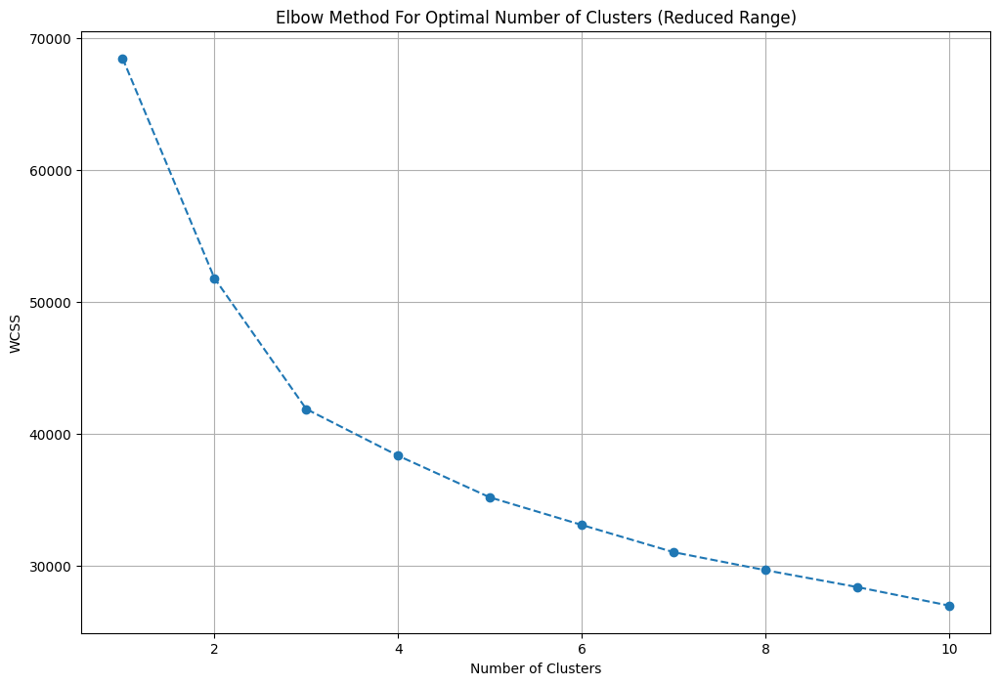

In [65]:
# Plot the results
plt.figure(figsize=(12, 8))
plt.plot(range(1,11), wcss_reduced, marker='o', linestyle='--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [66]:
n_clusters = 3

# Fit the KMeans model
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
kmeans.fit(scaler_data)

# Predict the cluster assignments for each row
cluster_assignments = kmeans.predict(scaler_data)

C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [67]:
df = df.iloc[:,:-18]

In [68]:
df['furnishing_type'] = cluster_assignments

In [69]:
df['furnishing_type'].value_counts()

furnishing_type
0    2513
2    1075
1     215
Name: count, dtype: int64

# 5.features

In [73]:
df[['features','furnishDetails']]

,features,furnishDetails
0,"['Security / Fire Alarm', 'Intercom Facility',...","['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W..."
1,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo...",NaN
2,"['Private Garden / Terrace', 'High Ceiling Hei...","['1 Water Purifier', '14 Fan', '1 Exhaust Fan'..."
3,"['Feng Shui / Vaastu Compliant', 'Private Gard...",NaN
4,"['Feng Shui / Vaastu Compliant', 'Security / F...","['6 AC', 'No Bed', 'No Chimney', 'No Curtains'..."
5,NaN,[]
6,"['Water purifier', 'Security / Fire Alarm', 'P...","['5 Wardrobe', '5 Fan', '1 Exhaust Fan', '3 Ge..."
7,"['Feng Shui / Vaastu Compliant', 'Security / F...","['2 Wardrobe', '5 Fan', '1 Exhaust Fan', '1 Ge..."
8,NaN,NaN
9,NaN,"['1 Light', 'No AC', 'No Bed', 'No Chimney', '..."


In [75]:
df['features'].isnull().sum()

635

In [76]:
app_df = pd.read_csv('appartments.csv')
app_df.head(5)

,PropertyName,PropertySubName,NearbyLocations,LocationAdvantages,Link,PriceDetails,TopFacilities
0,Smartworld One DXP,"2, 3, 4 BHK Apartment in Sector 113, Gurgaon","['Bajghera Road', 'Palam Vihar Halt', 'DPSG Pa...","{'Bajghera Road': '800 Meter', 'Palam Vihar Ha...",https://www.99acres.com/smartworld-one-dxp-sec...,"{'2 BHK': {'building_type': 'Apartment', 'area...","['Swimming Pool', 'Salon', 'Restaurant', 'Spa'..."
1,M3M Crown,"3, 4 BHK Apartment in Sector 111, Gurgaon","['DPSG Palam Vihar Gurugram', 'The NorthCap Un...","{'DPSG Palam Vihar Gurugram': '1.4 Km', 'The N...",https://www.99acres.com/m3m-crown-sector-111-g...,"{'3 BHK': {'building_type': 'Apartment', 'area...","['Bowling Alley', 'Mini Theatre', 'Manicured G..."
2,Adani Brahma Samsara Vilasa,"Land, 3, 4 BHK Independent Floor in Sector 63,...","['AIPL Business Club Sector 62', 'Heritage Xpe...","{'AIPL Business Club Sector 62': '2.7 Km', 'He...",https://www.99acres.com/adani-brahma-samsara-v...,{'3 BHK': {'building_type': 'Independent Floor...,"['Terrace Garden', 'Gazebo', 'Fountain', 'Amph..."
3,Sobha City,"2, 3, 4 BHK Apartment in Sector 108, Gurgaon","['The Shikshiyan School', 'WTC Plaza', 'Luxus ...","{'The Shikshiyan School': '2.9 KM', 'WTC Plaza...",https://www.99acres.com/sobha-city-sector-108-...,"{'2 BHK': {'building_type': 'Apartment', 'area...","['Swimming Pool', 'Volley Ball Court', 'Aerobi..."
4,Signature Global City 93,"2, 3 BHK Independent Floor in Sector 93 Gurgaon","['Pranavananda Int. School', 'DLF Site central...","{'Pranavananda Int. School': '450 m', 'DLF Sit...",https://www.99acres.com/signature-global-city-...,{'2 BHK': {'building_type': 'Independent Floor...,"['Mini Theatre', 'Doctor on Call', 'Concierge ..."


In [80]:
app_df['PropertyName'] = app_df['PropertyName'].str.lower()

In [87]:
temp_df =  df[df['features'].isnull()]

In [88]:
temp_df.shape

(635, 26)

In [91]:
x = temp_df.merge(app_df,left_on = 'society',right_on = 'PropertyName',how = 'left')['TopFacilities']

In [92]:
x

0                                                    NaN
1                                                    NaN
2      ['Swimming Pool', 'Barbecue', 'Pergola', 'Saun...
3                                                    NaN
4                                                    NaN
5                                                    NaN
6                                                    NaN
7                                                    NaN
8                                                    NaN
9                                                    NaN
10                                                   NaN
11                                                   NaN
12     ['Manicured Garden', 'Swimming Pool', 'School'...
13     ['Infinity Pool', 'Swimming Pool', 'Reflexolog...
14                                                   NaN
15                                                   NaN
16                                                   NaN
17                             

In [96]:
df.loc[temp_df.index,'features'] = x.values

In [98]:
df['features'].isnull().sum()

482

In [99]:
from sklearn.preprocessing import MultiLabelBinarizer
import ast

In [101]:
df['features_list'] = df['features'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) and x.startswith('[') else [])

In [104]:
type(df['features_list'])

pandas.core.series.Series

In [105]:
mlb = MultiLabelBinarizer()

In [106]:
features_binary_matrix = mlb.fit_transform(df['features_list'])

In [107]:
features_binary_matrix

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 0, ..., 1, 0, 0]])

In [110]:
features_binary_df = pd.DataFrame(features_binary_matrix,columns = mlb.classes_)

In [111]:
features_binary_df.head(5)

,24/7 Power Backup,24/7 Water Supply,24x7 Security,ATM,Aerobics Centre,Air Hockey,Airy Rooms,Amphitheatre,Automated Car Wash,Badminton Court,Bank Attached Property,Banquet Hall,Bar/Chill-Out Lounge,Barbecue,Basketball Court,Beach Volley Ball Court,Billiards,Bowling Alley,Bus Shelter,Business Lounge,CCTV Camera Security,Cafeteria,Car Parking,Car wash area,Card Room,Centrally Air Conditioned,Changing Area,Children's Play Area,Cigar Lounge,Clinic,Club House,Club house / Community Center,Community Hall,Concierge Service,Conference room,Creche/Day care,Cricket Pitch,Doctor on Call,Earthquake Resistant,Entrance Lobby,False Ceiling Lighting,Feng Shui / Vaastu Compliant,Fire Fighting Systems,Fitness Centre / GYM,Flower Garden,Food Court,Foosball,Football,Fountain,Gated Community,Gazebo,Golf Course,Grocery Shop,Gymnasium,High Ceiling Height,High Speed Elevators,Infinity Pool,Intercom Facility,Internal Street Lights,Internet/wi-fi connectivity,Jacuzzi,Jogging Track,Landscape Garden,Laundry,Lawn Tennis Court,Library,Lift(s),Lounge,Low Density Society,Maintenance Staff,Manicured Garden,Medical Centre,Milk Booth,Mini Theatre,Multipurpose Court,Multipurpose Hall,Natural Light,Natural Pond,No open drainage around,Park,Party Lawn,Pergola,Piped Gas,Piped-gas,Pool Table,Power Back up Lift,Power Back-up,Private Garden / Terrace,Property Staff,RO System,Rain Water Harvesting,Reading Lounge,Recently Renovated,Reflexology Park,Restaurant,Salon,Sauna,School,Security / Fire Alarm,Security Personnel,Separate entry for servant room,Sewage Treatment Plant,Shopping Centre,Skating Rink,Solar Lighting,Solar Water Heating,Spa,Spacious Interiors,Squash Court,Steam Room,Sun Deck,Swimming Pool,Temple,Terrace Garden,Theatre,Toddler Pool,Valet Parking,Vastu Compliant,Video Door Security,Visitor Parking,Visitors Parking,Volley Ball Court,Waiting Lounge,Waste Disposal,Water Softener Plant,Water Storage,Water purifier,Water softening plant,Wi-Fi Connectivity,Yoga/Meditation Area
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0


In [112]:
features_binary_df.shape

(3803, 130)

In [114]:
wcc_reduced = []

for i in range(1,11):
    kmean = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    
    kmean.fit(features_binary_df)
    
    wcc_reduced.append(kmean.inertia_)

C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\patha\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of

In [115]:
wcc_reduced

[26666.312910859793,
 17571.318875424582,
 15217.306880205404,
 13524.042187114395,
 12576.629274303465,
 11785.387023868418,
 11277.893370954847,
 10894.348651573859,
 10554.247269106401,
 10289.729825365812]

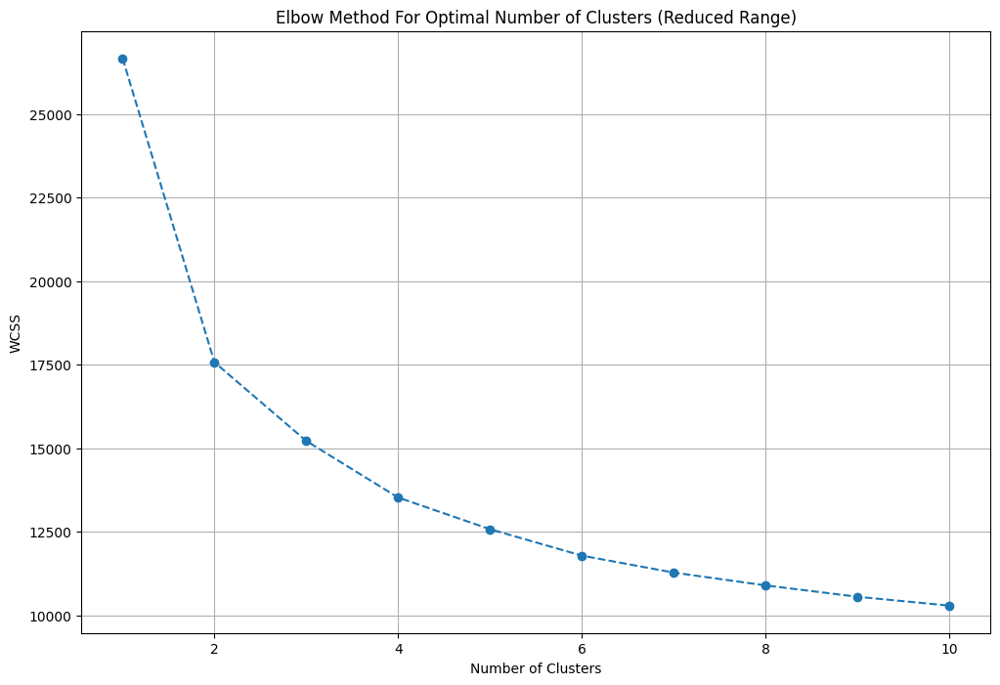

In [116]:
plt.figure(figsize = (12,8))

plt.plot(range(1,11),wcc_reduced,marker = 'o',linestyle = '--')
plt.title('Elbow Method For Optimal Number of Clusters (Reduced Range)')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

In [117]:
# Define the weights for each feature as provided
# Assigning weights based on perceived luxury contribution
weights = {
    '24/7 Power Backup': 8,
    '24/7 Water Supply': 4,
    '24x7 Security': 7,
    'ATM': 4,
    'Aerobics Centre': 6,
    'Airy Rooms': 8,
    'Amphitheatre': 7,
    'Badminton Court': 7,
    'Banquet Hall': 8,
    'Bar/Chill-Out Lounge': 9,
    'Barbecue': 7,
    'Basketball Court': 7,
    'Billiards': 7,
    'Bowling Alley': 8,
    'Business Lounge': 9,
    'CCTV Camera Security': 8,
    'Cafeteria': 6,
    'Car Parking': 6,
    'Card Room': 6,
    'Centrally Air Conditioned': 9,
    'Changing Area': 6,
    "Children's Play Area": 7,
    'Cigar Lounge': 9,
    'Clinic': 5,
    'Club House': 9,
    'Concierge Service': 9,
    'Conference room': 8,
    'Creche/Day care': 7,
    'Cricket Pitch': 7,
    'Doctor on Call': 6,
    'Earthquake Resistant': 5,
    'Entrance Lobby': 7,
    'False Ceiling Lighting': 6,
    'Feng Shui / Vaastu Compliant': 5,
    'Fire Fighting Systems': 8,
    'Fitness Centre / GYM': 8,
    'Flower Garden': 7,
    'Food Court': 6,
    'Foosball': 5,
    'Football': 7,
    'Fountain': 7,
    'Gated Community': 7,
    'Golf Course': 10,
    'Grocery Shop': 6,
    'Gymnasium': 8,
    'High Ceiling Height': 8,
    'High Speed Elevators': 8,
    'Infinity Pool': 9,
    'Intercom Facility': 7,
    'Internal Street Lights': 6,
    'Internet/wi-fi connectivity': 7,
    'Jacuzzi': 9,
    'Jogging Track': 7,
    'Landscape Garden': 8,
    'Laundry': 6,
    'Lawn Tennis Court': 8,
    'Library': 8,
    'Lounge': 8,
    'Low Density Society': 7,
    'Maintenance Staff': 6,
    'Manicured Garden': 7,
    'Medical Centre': 5,
    'Milk Booth': 4,
    'Mini Theatre': 9,
    'Multipurpose Court': 7,
    'Multipurpose Hall': 7,
    'Natural Light': 8,
    'Natural Pond': 7,
    'Park': 8,
    'Party Lawn': 8,
    'Piped Gas': 7,
    'Pool Table': 7,
    'Power Back up Lift': 8,
    'Private Garden / Terrace': 9,
    'Property Staff': 7,
    'RO System': 7,
    'Rain Water Harvesting': 7,
    'Reading Lounge': 8,
    'Restaurant': 8,
    'Salon': 8,
    'Sauna': 9,
    'Security / Fire Alarm': 9,
    'Security Personnel': 9,
    'Separate entry for servant room': 8,
    'Sewage Treatment Plant': 6,
    'Shopping Centre': 7,
    'Skating Rink': 7,
    'Solar Lighting': 6,
    'Solar Water Heating': 7,
    'Spa': 9,
    'Spacious Interiors': 9,
    'Squash Court': 8,
    'Steam Room': 9,
    'Sun Deck': 8,
    'Swimming Pool': 8,
    'Temple': 5,
    'Theatre': 9,
    'Toddler Pool': 7,
    'Valet Parking': 9,
    'Video Door Security': 9,
    'Visitor Parking': 7,
    'Water Softener Plant': 7,
    'Water Storage': 7,
    'Water purifier': 7,
    'Yoga/Meditation Area': 7
}



In [124]:
df['luxury_score'] = features_binary_df[list(weights.keys())].multiply(list(weights.values())).sum(axis=1)

In [125]:
df.head(5)

,property_type,society,sector,price,price_per_sqft,area,areaWithType,bedRoom,bathroom,balcony,additionalRoom,floorNum,facing,agePossession,nearbyLocations,furnishDetails,features,super_built_up_area,Built_Up_area,Carpet_area,study room,store room,pooja room,servant room,others,furnishing_type,features_list,luxury_score
0,flat,ambience creacions,sector 22,3.99,12912.0,3090.00,Super Built up area 3090(287.07 sq.m.),3.0,5.0,3+,servant room,3.0,NaN,New Property,"['Moulsari Avenue', 'Ambience Mall', 'Old Delh...","['1 Fridge', '1 Exhaust Fan', '4 Geyser', '1 W...","['Security / Fire Alarm', 'Intercom Facility',...",3090.0,NaN,NaN,0,0,0,1,0,1,"[Security / Fire Alarm, Intercom Facility, Lif...",102
1,flat,raheja revanta,sector 78,1.20,10018.0,1198.00,Super Built up area 1197.8(111.28 sq.m.)Carpet...,1.0,2.0,2,notavailabe,32.0,NaN,Under Construction,"['Sapphire 83 Mall', 'NH-8', 'Bal Bharti Publi...",NaN,"['Lift(s)', 'Maintenance Staff', 'Swimming Poo...",1197.8,NaN,505.0,0,0,0,0,0,0,"[Lift(s), Maintenance Staff, Swimming Pool, Pa...",39
2,house,notAvailable,sector 12,3.50,133079.0,258.33,Plot area 263(24.43 sq.m.)Built Up area: 4800 ...,8.0,8.0,3+,"pooja room,study room,servant room",3.0,South-East,Relatively New,"['Hanuman Mandir', 'Dental Health Centre', 'No...","['1 Water Purifier', '14 Fan', '1 Exhaust Fan'...","['Private Garden / Terrace', 'High Ceiling Hei...",NaN,4800.0,4400.0,1,0,1,1,0,1,"[Private Garden / Terrace, High Ceiling Height...",77
3,house,notAvailable,sector 43,13.50,50000.0,2701.74,Plot area 300(250.84 sq.m.),16.0,16.0,3+,"pooja room,study room,servant room,others",4.0,North-West,Relatively New,"['Huda city centre metro station', 'New Life C...",NaN,"['Feng Shui / Vaastu Compliant', 'Private Gard...",NaN,2700.0,NaN,1,0,1,1,1,0,"[Feng Shui / Vaastu Compliant, Private Garden ...",41
4,flat,ss the leaf,sector 85,2.10,7467.0,2812.00,Super Built up area 2812(261.24 sq.m.)Built Up...,4.0,4.0,3,"pooja room,study room,servant room",7.0,North,Relatively New,"['Sapphire 83 Mall', 'Dwarka Expressway', 'Cen...","['6 AC', 'No Bed', 'No Chimney', 'No Curtains'...","['Feng Shui / Vaastu Compliant', 'Security / F...",2812.0,2600.0,2400.0,1,0,1,1,0,0,"[Feng Shui / Vaastu Compliant, Security / Fire...",49


In [126]:
# cols to drop -> nearbyLocations,furnishDetails, features,features_list, additionalRoom
df.drop(columns=['nearbyLocations','furnishDetails','features','features_list','additionalRoom'],inplace=True)

In [128]:
df.shape

(3803, 23)

In [129]:
df.to_csv('gurgaon_properties_cleaned_v2.csv',index = False)